# New York Air Bnb price prediction

### First import all needed libreries

In [1]:
%matplotlib notebook
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from datetime import datetime
import requests
from pandas.io.json import json_normalize
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Lasso
from sklearn.cluster import KMeans 
from sklearn.ensemble import RandomForestRegressor

### Data

In [2]:
df = pd.read_csv("C:\\Users\\praba\\Desktop\\Notebook\\AB_NYC_2019.csv")
df

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48890,36484665,Charming one bedroom - newly renovated rowhouse,8232441,Sabrina,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,70,2,0,NaN,NaN,2,9
48891,36485057,Affordable room in Bushwick/East Williamsburg,6570630,Marisol,Brooklyn,Bushwick,40.70184,-73.93317,Private room,40,4,0,NaN,NaN,2,36
48892,36485431,Sunny Studio at Historical Neighborhood,23492952,Ilgar & Aysel,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,115,10,0,NaN,NaN,1,27
48893,36485609,43rd St. Time Square-cozy single bed,30985759,Taz,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,55,1,0,NaN,NaN,6,2


### Foursquare data

This data is based on the Airbnb chosed by user > I am just taking an example.

In [3]:
url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&ll={},{}&v={}&radius={}&limit={}'.format("ZDX411MKWKGTKXXPOTDIGCMPGD3UCJ4B1RME2ACZU2PH0F01", "KTDTBROQURLMAZPQXEMXDA5FL245EFRHFHJEAD0AQ4Q3FAVM", 40.71232,-73.94220, '20180604',1000,30)
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5ee3d1e75f782d7169a2af02'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'},
    {'name': '$-$$$$', 'key': 'price'}]},
  'headerLocation': 'East Williamsburg',
  'headerFullLocation': 'East Williamsburg, Brooklyn',
  'headerLocationGranularity': 'neighborhood',
  'totalResults': 216,
  'suggestedBounds': {'ne': {'lat': 40.72132000900001,
    'lng': -73.93034871390738},
   'sw': {'lat': 40.70331999099999, 'lng': -73.95405128609262}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '5756fe64498e1d047fa8c59b',
       'name': 'Osakana',
       'location': {'address': '290 Graham Ave',
        'crossStreet': 'btwn Powers St & Grand St',
        'lat': 40.71221754698879,
    

In [4]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']
items = results['response']['groups'][0]['items']
items[0]
dataframe = json_normalize(items) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories'] + [col for col in dataframe.columns if col.startswith('venue.location.')] + ['venue.id']
df2 = dataframe.loc[:, filtered_columns]

# filter the category for each row
df2['venue.categories'] = df2.apply(get_category_type, axis=1)

# clean columns
df2.columns = [col.split('.')[-1] for col in df2.columns]

df2[['name', 'categories', 'address','crossStreet','lat','lng','distance']] .head(10)

<ipython-input-4-0f538166e6c2>:14: FutureWarning: pandas.io.json.json_normalize is deprecated, use pandas.json_normalize instead
  dataframe = json_normalize(items) # flatten JSON


,name,categories,address,crossStreet,lat,lng,distance
0,Osakana,Fish Market,290 Graham Ave,btwn Powers St & Grand St,40.712218,-73.943838,138
1,Then She Fell,Indie Theater,195 Maujer St,NaN,40.711029,-73.942940,156
2,Ammazza Caffe,Italian Restaurant,702 Grand St,NaN,40.711543,-73.944574,218
3,Tuffet,Bar,286 Graham Ave,btwn Grand St & Powers St,40.712112,-73.943921,147
4,Charter Coffeehouse,Coffee Shop,309 Graham Ave,Devoe & Ainslie,40.713273,-73.944340,209
5,Sage Brooklyn,Thai Restaurant,299-301 Graham Ave,at Ainslie St.,40.713060,-73.944202,187
6,Artist & Craftsman Supply,Arts & Crafts Store,761 Metropolitan Ave,NaN,40.714691,-73.943534,286
7,Easy Lover,Cocktail Bar,790 Metropolitan Ave,NaN,40.714699,-73.942660,267
8,To The World Farm,Market,655 Grand St,btwn Leonard St & Manhattan Ave,40.711445,-73.946143,346
9,Hungry Ghost,Coffee Shop,721 Metropolitan Ave,btwm Manhattan & Graham Ave,40.714567,-73.945016,344


### Cleaning and exploration of data

In [5]:
df.fillna({'name':"NoName"}, inplace=True)
df.fillna({'host_name':"NoName"}, inplace=True)
df['reviews_per_month'] = df['reviews_per_month'].replace(np.nan, 0)
df['last_review'] = df['last_review'].replace(np.nan,datetime.date(datetime.now()))
df = df[df.price != 0]
df.dropna()
df

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,2020-06-13,0.00,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48890,36484665,Charming one bedroom - newly renovated rowhouse,8232441,Sabrina,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,70,2,0,2020-06-13,0.00,2,9
48891,36485057,Affordable room in Bushwick/East Williamsburg,6570630,Marisol,Brooklyn,Bushwick,40.70184,-73.93317,Private room,40,4,0,2020-06-13,0.00,2,36
48892,36485431,Sunny Studio at Historical Neighborhood,23492952,Ilgar & Aysel,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,115,10,0,2020-06-13,0.00,1,27
48893,36485609,43rd St. Time Square-cozy single bed,30985759,Taz,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,55,1,0,2020-06-13,0.00,6,2


In [6]:
df['neighbourhood_group'].value_counts()

Manhattan        21660
Brooklyn         20095
Queens            5666
Bronx             1090
Staten Island      373
Name: neighbourhood_group, dtype: int64

<IPython.core.display.Javascript object>


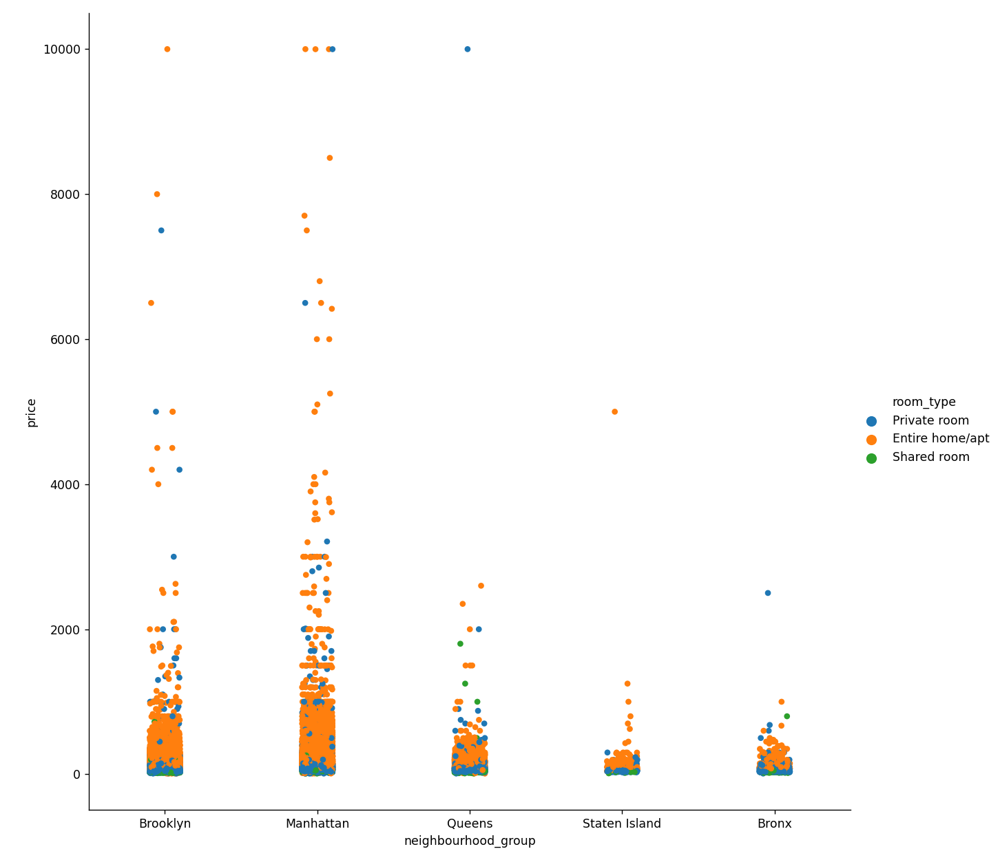

In [7]:
ax = sns.catplot(x="neighbourhood_group", y="price",hue="room_type",height = 10, data=df)

<IPython.core.display.Javascript object>


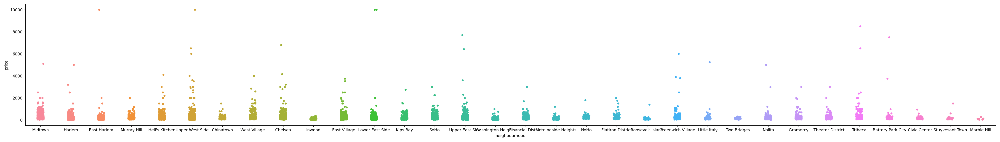

In [8]:
dfnm = df.loc[df['neighbourhood_group']=='Manhattan']
ax = sns.catplot(x="neighbourhood", y="price",aspect=7, data=dfnm)

### Clustering data on latitude and logitude

In [9]:
li=[]
kx = df[['latitude','longitude']]
kmeans = KMeans(n_clusters=6, random_state=0).fit(kx)
li = kmeans.labels_
df['Cluster'] = pd.Series(li)
df.dropna()

<ipython-input-9-ef735cbe98a2>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Cluster'] = pd.Series(li)


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,Cluster
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365,4.0
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355,5.0
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,2020-06-13,0.00,1,365,3.0
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194,1.0
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48879,36480292,Gorgeous 1.5 Bdr with a private yard- Williams...,540335,Lee,Brooklyn,Williamsburg,40.71728,-73.94394,Entire home/apt,120,20,0,2020-06-13,0.00,1,22,1.0
48880,36481315,The Raccoon Artist Studio in Williamsburg New ...,208514239,Melki,Brooklyn,Williamsburg,40.71232,-73.94220,Entire home/apt,120,1,0,2020-06-13,0.00,3,365,1.0
48881,36481615,"Peaceful space in Greenpoint, BK",274298453,Adrien,Brooklyn,Greenpoint,40.72585,-73.94001,Private room,54,6,0,2020-06-13,0.00,1,15,3.0
48882,36482231,Bushwick _ Myrtle-Wyckoff,66058896,Luisa,Brooklyn,Bushwick,40.69652,-73.91079,Private room,40,20,0,2020-06-13,0.00,1,31,5.0


<IPython.core.display.Javascript object>


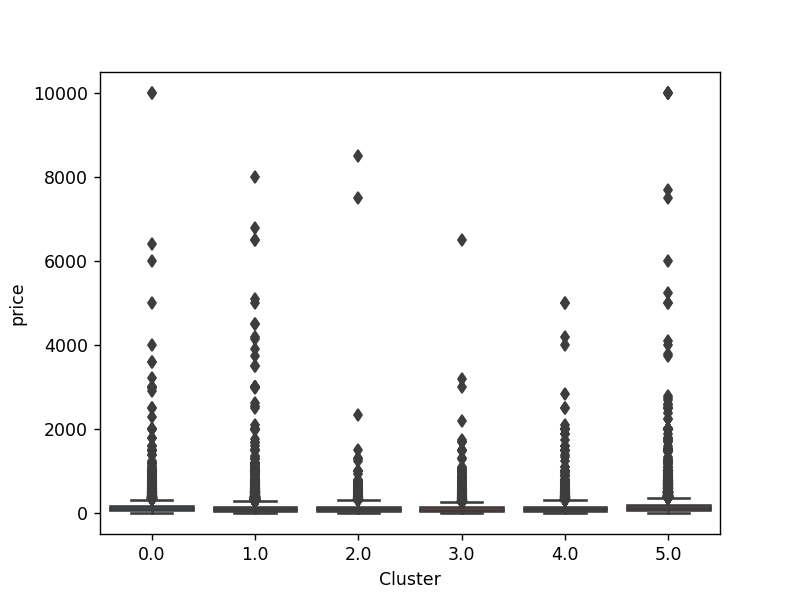

In [10]:
ax = sns.boxplot(x="Cluster", y="price", data=df)

As there are so many outliers we need to remove them

In [11]:
dfn = df.loc[df['price']<250]
dfn

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,Cluster
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365,4.0
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355,5.0
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,2020-06-13,0.00,1,365,3.0
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194,1.0
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48890,36484665,Charming one bedroom - newly renovated rowhouse,8232441,Sabrina,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,70,2,0,2020-06-13,0.00,2,9,NaN
48891,36485057,Affordable room in Bushwick/East Williamsburg,6570630,Marisol,Brooklyn,Bushwick,40.70184,-73.93317,Private room,40,4,0,2020-06-13,0.00,2,36,NaN
48892,36485431,Sunny Studio at Historical Neighborhood,23492952,Ilgar & Aysel,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,115,10,0,2020-06-13,0.00,1,27,NaN
48893,36485609,43rd St. Time Square-cozy single bed,30985759,Taz,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,55,1,0,2020-06-13,0.00,6,2,NaN


<IPython.core.display.Javascript object>


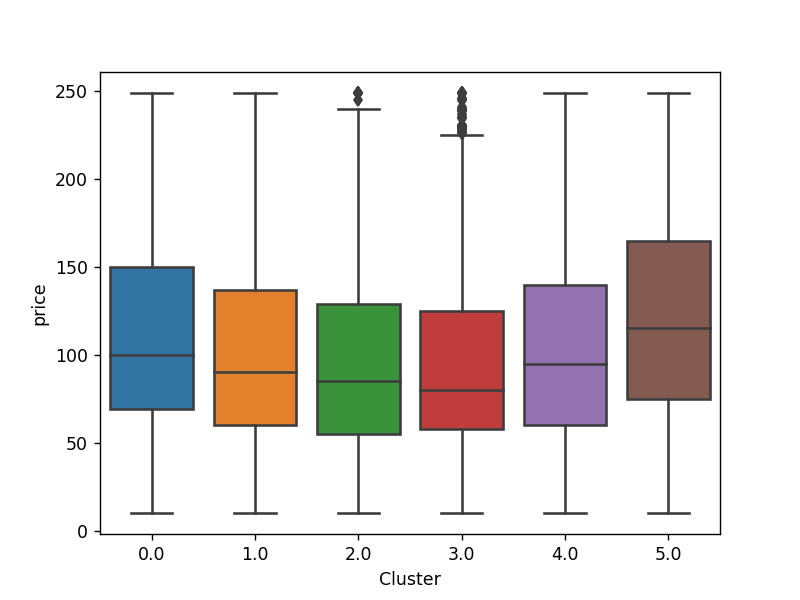

In [12]:
ax = sns.boxplot(x="Cluster", y="price", data=dfn)

<IPython.core.display.Javascript object>


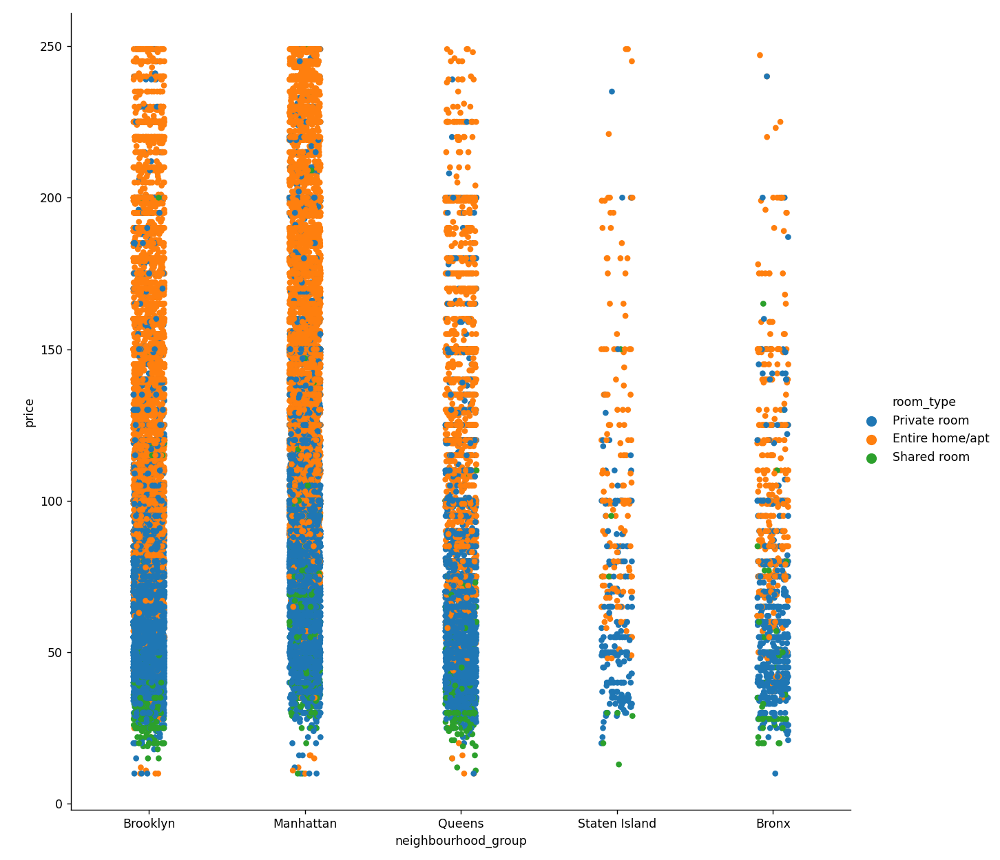

In [13]:
ax = sns.catplot(x="neighbourhood_group", y="price",hue="room_type",height = 10, data=dfn)

<IPython.core.display.Javascript object>


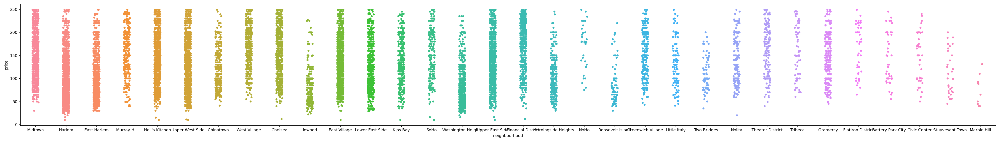

In [14]:
dfnm = dfn.loc[df['neighbourhood_group']=='Manhattan']
ax = sns.catplot(x="neighbourhood", y="price",aspect=7, data=dfnm)

<IPython.core.display.Javascript object>


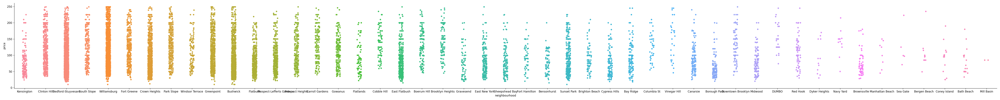

In [15]:
dfnm = dfn.loc[df['neighbourhood_group']=='Brooklyn']
ax = sns.catplot(x="neighbourhood", y="price",aspect=10, data=dfnm)

<IPython.core.display.Javascript object>


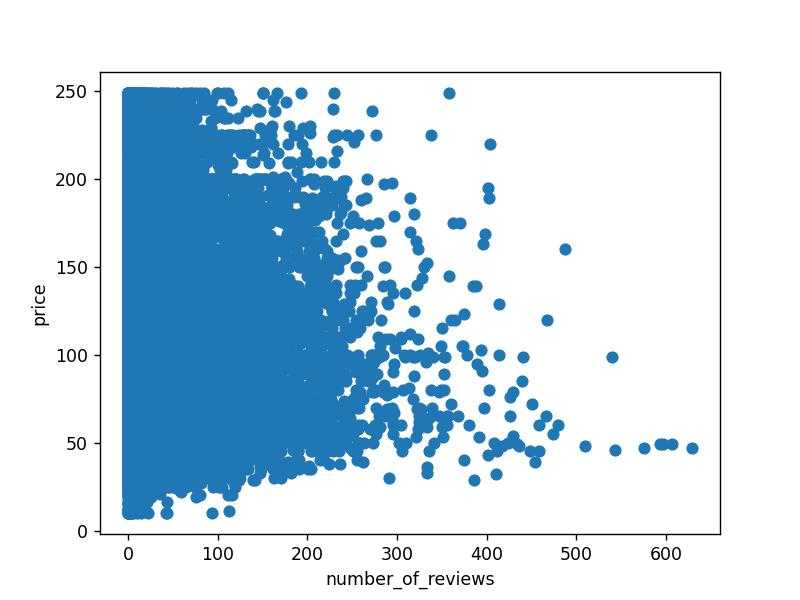

In [16]:
plt.figure()
plt.scatter("number_of_reviews", "price", data=dfn)
plt.xlabel('number_of_reviews')
plt.ylabel('price')
plt.show()

<IPython.core.display.Javascript object>


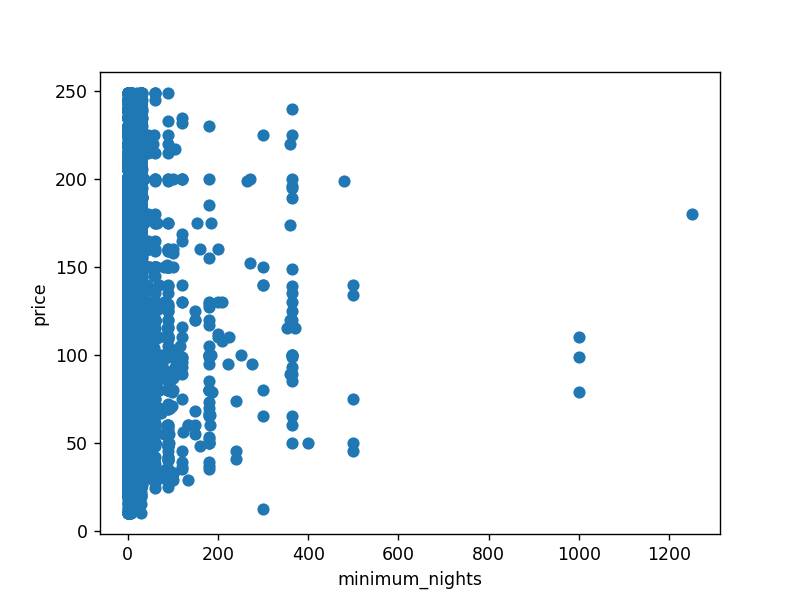

In [17]:
plt.figure()
plt.scatter("minimum_nights", "price", data=dfn)
plt.xlabel('minimum_nights')
plt.ylabel('price')
plt.show()

In [20]:
map2= folium.Map(location=[40.71232,-73.94220], zoom_start=10)
clr = {'Manhattan':'purple','Brooklyn':'blue','Queens':'orange','Bronx':'red','Staten Island':'green'} 
for lat, lng, label,c in zip(dfn['latitude'], dfn['longitude'], dfn['id'],dfn['neighbourhood_group']):
    clar = clr[c]
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color=clar,
        fill=True,
        fill_color='lightblue',
        fill_opacity=0.7,
        parse_html=False).add_to(map2)  
    

In [21]:
map2

### Coverting data in desirable datatypes

In [22]:
dfn.dtypes

id                                  int64
name                               object
host_id                             int64
host_name                          object
neighbourhood_group                object
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
Cluster                           float64
dtype: object

In [23]:
dfn['room_type'].replace(to_replace=['Entire home/apt','Private room','Shared room'], value=[0,1,2],inplace=True)
li1 = list(range(0, 219))
li2 = dfn['neighbourhood'].values.tolist()
li2 = list( dict.fromkeys(li2) )
dfn['neighbourhood'].replace(to_replace=li2, value=li1,inplace=True)
dfn['neighbourhood_group'].replace(to_replace=['Manhattan','Brooklyn','Queens','Bronx','Staten Island'], value=[0,1,2,3,4],inplace=True)
dfn.dropna(inplace= True)

c:\python3.8.1\lib\site-packages\pandas\core\generic.py:6746: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._update_inplace(new_data)
<ipython-input-23-fd5d1424e2e2>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfn.dropna(inplace= True)


In [24]:
dfn.dtypes

id                                  int64
name                               object
host_id                             int64
host_name                          object
neighbourhood_group                 int64
neighbourhood                       int64
latitude                          float64
longitude                         float64
room_type                           int64
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
Cluster                           float64
dtype: object

### Predicting Price

#### Train and Test data

In [25]:
X = dfn[['room_type','neighbourhood','neighbourhood_group','Cluster','reviews_per_month','number_of_reviews','minimum_nights','availability_365','calculated_host_listings_count']]
y = dfn['price']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

#### Using Lasso

In [26]:
reg = Lasso(alpha = 1.0).fit(X_train, y_train)
yhat = reg.predict(X_test)
score = reg.score(X_test, y_test)
print(score)

0.469458223871693


As we can see in Lasso score is very low so I will use RandomForest Regression

#### Using RandomForestRegressor

In [27]:
ran = RandomForestRegressor(n_estimators=300, max_depth = 50, min_samples_split = 5,min_samples_leaf =4).fit(X_train, y_train)
yhat = ran.predict(X_test)
score = ran.score(X_train, y_train)
print(score)

0.7898807316942643


#### Now User will use the Airbnb and get venues around it. 

##### Here i used one directly

In [28]:
url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&ll={},{}&v={}&radius={}&limit={}'.format("ZDX411MKWKGTKXXPOTDIGCMPGD3UCJ4B1RME2ACZU2PH0F01", "KTDTBROQURLMAZPQXEMXDA5FL245EFRHFHJEAD0AQ4Q3FAVM", 40.71232,-73.94220, '20180604',1000,30)
results = requests.get(url).json()
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']
items = results['response']['groups'][0]['items']
items[0]
dataframe = json_normalize(items) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories'] + [col for col in dataframe.columns if col.startswith('venue.location.')] + ['venue.id']
df2 = dataframe.loc[:, filtered_columns]

# filter the category for each row
df2['venue.categories'] = df2.apply(get_category_type, axis=1)

# clean columns
df2.columns = [col.split('.')[-1] for col in df2.columns]

df2[['name', 'categories', 'address','crossStreet','lat','lng','distance']] .head()

<ipython-input-28-c0c3ccc76010>:16: FutureWarning: pandas.io.json.json_normalize is deprecated, use pandas.json_normalize instead
  dataframe = json_normalize(items) # flatten JSON


,name,categories,address,crossStreet,lat,lng,distance
0,Osakana,Fish Market,290 Graham Ave,btwn Powers St & Grand St,40.712218,-73.943838,138
1,Then She Fell,Indie Theater,195 Maujer St,NaN,40.711029,-73.942940,156
2,Ammazza Caffe,Italian Restaurant,702 Grand St,NaN,40.711543,-73.944574,218
3,Tuffet,Bar,286 Graham Ave,btwn Grand St & Powers St,40.712112,-73.943921,147
4,Charter Coffeehouse,Coffee Shop,309 Graham Ave,Devoe & Ainslie,40.713273,-73.944340,209


In [31]:
map1= folium.Map(location=[40.71232,-73.94220], zoom_start=15)

for lat, lng, label in zip(df2['lat'], df2['lng'], df2['name']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=8,
        popup=label,
        color='voilet',
        fill=True,
        fill_color='red',
        fill_opacity=0.7,
        parse_html=False).add_to(map1)  
    

In [32]:
map1